In [1]:
import mamimo

In [2]:
import pandas as pd

df = pd.read_csv('../raw_data/df_clean.csv')
df = df.drop(columns='Unnamed: 0')
df['Day'] = pd.to_datetime(df['Day'])
df.set_index('Day', inplace=True)
df = df.rename(columns={"fb_costs": "facebook", "google_costs": "google", "tt_costs": "tiktok"})

# create a simple dataframe

simple_df = df.drop(columns = ['fb_impressions', 'fb_clicks', 'google_impressions', 'google_clicks', 'tt_impressions', 'tt_clicks'])

X_simple = simple_df.drop(columns = ['orders', 'total_sales']) # 2 channels: facebook and google
y_simple = simple_df['total_sales'] # for now lets just use total_sales and exclude orders

In [3]:
simple_df

,orders,total_sales,facebook,google,tiktok
Day,,,,,
2021-07-01,10,414.85,257.01,1.17,0.0
2021-07-02,6,229.95,250.30,0.84,0.0
2021-07-03,10,459.89,248.59,0.72,0.0
2021-07-04,17,508.36,258.05,0.07,0.0
2021-07-05,13,399.88,257.47,0.38,0.0
...,...,...,...,...,...
2023-08-20,294,13616.97,2148.53,466.56,0.0
2023-08-21,356,15348.42,2210.01,400.58,0.0
2023-08-22,150,6054.53,1335.84,289.46,0.0


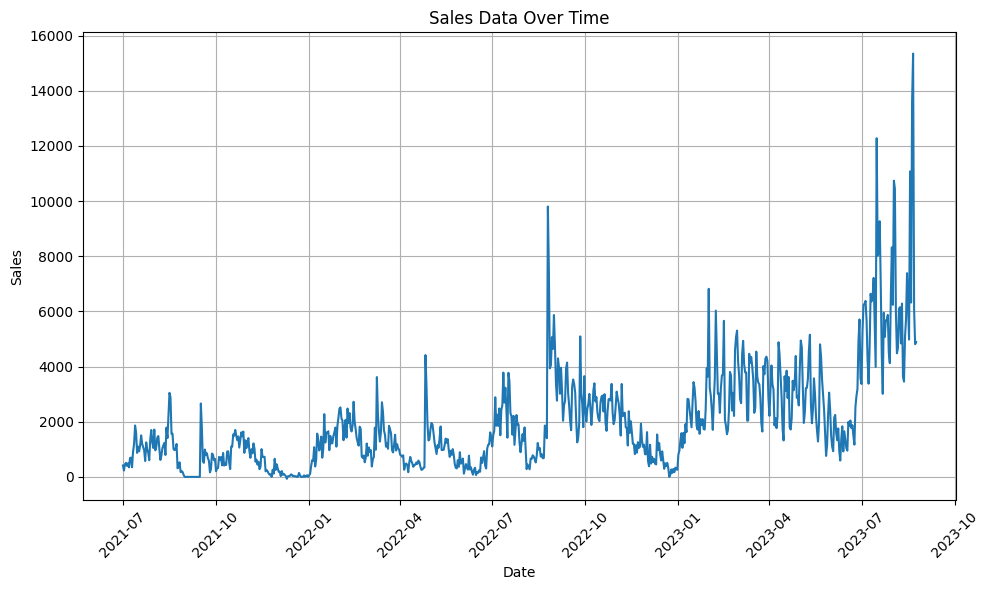

In [4]:
import matplotlib.pyplot as plt

# Plotting
plt.figure(figsize=(10, 6))  # Adjust the figure size as needed
plt.plot(df.index, y_simple, linestyle='-')
plt.title('Sales Data Over Time')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.grid(True)
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability

plt.tight_layout()
plt.show()

# When do the spikes happen?

In [5]:
# Specify the date range
start_date = '2022-04-01'
end_date = '2022-07-01'

# Select the date range
selected_range = df.loc[start_date:end_date]

# Find the date on which the maximum value occurred
date_of_max = selected_range['total_sales'].idxmax()

date_of_max

Timestamp('2022-04-26 00:00:00')

In [6]:
start_date = '2022-07-01'
end_date = '2022-10-01'

# Select the date range
selected_range = df.loc[start_date:end_date]

# Find the date on which the maximum value occurred
date_of_max = selected_range['total_sales'].idxmax()

date_of_max

Timestamp('2022-08-25 00:00:00')

In [7]:
start_date = '2023-07-01'
end_date = '2023-10-01'

# Select the date range
selected_range = df.loc[start_date:end_date]

# Find the date on which the maximum value occurred
date_of_max = selected_range['total_sales'].idxmax()

date_of_max

Timestamp('2023-08-21 00:00:00')

In [8]:
simple_df

,orders,total_sales,facebook,google,tiktok
Day,,,,,
2021-07-01,10,414.85,257.01,1.17,0.0
2021-07-02,6,229.95,250.30,0.84,0.0
2021-07-03,10,459.89,248.59,0.72,0.0
2021-07-04,17,508.36,258.05,0.07,0.0
2021-07-05,13,399.88,257.47,0.38,0.0
...,...,...,...,...,...
2023-08-20,294,13616.97,2148.53,466.56,0.0
2023-08-21,356,15348.42,2210.01,400.58,0.0
2023-08-22,150,6054.53,1335.84,289.46,0.0


# Feature Engineering

# Modeling

In [9]:
from mamimo.carryover import ExponentialCarryover
from mamimo.saturation import ExponentialSaturation
from mamimo.linear_model import LinearRegression
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

adstock = ColumnTransformer(
    [
     ('facebook_pipe', Pipeline([
            ('carryover', ExponentialCarryover()),
            ('saturation', ExponentialSaturation())
     ]), ['facebook']),
     ('google_pipe', Pipeline([
            ('carryover', ExponentialCarryover()),
            ('saturation', ExponentialSaturation())
     ]), ['google']),
     ('tiktok_pipe', Pipeline([
            ('carryover', ExponentialCarryover()),
            ('saturation', ExponentialSaturation())
     ]), ['tiktok'])
])

model = Pipeline([
    ('adstock', adstock),
    ('regression', LinearRegression(positive=True))
])

In [10]:
model.fit(X_simple, y_simple).score(X_simple, y_simple)

0.15230789915639653

In [11]:
from scipy.stats import uniform, randint
from sklearn.model_selection import RandomizedSearchCV, TimeSeriesSplit

tuned_model = RandomizedSearchCV(
    model,
    param_distributions={
        'adstock__facebook_pipe__carryover__window': randint(1, 10),
        'adstock__facebook_pipe__carryover__strength': uniform(0, 1),
        'adstock__facebook_pipe__saturation__exponent': uniform(0, 1),
        'adstock__google_pipe__carryover__window': randint(1, 10),
        'adstock__google_pipe__carryover__strength': uniform(0, 1),
        'adstock__google_pipe__saturation__exponent': uniform(0, 1),
        'adstock__tiktok_pipe__carryover__window': randint(1, 10),
        'adstock__tiktok_pipe__carryover__strength': uniform(0, 1),
        'adstock__tiktok_pipe__saturation__exponent': uniform(0, 1)
    },
    cv=TimeSeriesSplit(),
    random_state=0,
    n_iter=100
)

In [12]:
tuned_model.fit(X_simple, y_simple)

RandomizedSearchCV(cv=TimeSeriesSplit(gap=0, max_train_size=None, n_splits=5, test_size=None),
                   estimator=Pipeline(steps=[('adstock',
                                              ColumnTransformer(transformers=[('facebook_pipe',
                                                                               Pipeline(steps=[('carryover',
                                                                                                ExponentialCarryover()),
                                                                                               ('saturation',
                                                                                                ExponentialSaturation())]),
                                                                               ['facebook']),
                                                                              ('google_pipe',
                                                                               Pipeline(steps=[('carryover',
                                                                                                ExponentialCarryover(...
                                        'adstock__tiktok_pipe__carryover__strength': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x14ad06440>,
                                        'adstock__tiktok_pipe__carryover__window': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x14ad06ad0>,
                                        'adstock__tiktok_pipe__saturation__exponent': <scipy.stats._distn_infrastructure.rv_continuous_frozen object at 0x14ad07d00>},
                   random_state=0)

In [13]:
tuned_model.best_params_

{'adstock__facebook_pipe__carryover__strength': 0.8310484552361904,
 'adstock__facebook_pipe__carryover__window': 8,
 'adstock__facebook_pipe__saturation__exponent': 5.535686500857118e-05,
 'adstock__google_pipe__carryover__strength': 0.3118602206821891,
 'adstock__google_pipe__carryover__window': 8,
 'adstock__google_pipe__saturation__exponent': 0.7980468339125637,
 'adstock__tiktok_pipe__carryover__strength': 0.1856359443059522,
 'adstock__tiktok_pipe__carryover__window': 5,
 'adstock__tiktok_pipe__saturation__exponent': 0.456129772122862}

In [14]:
tuned_model.fit(X_simple, y_simple).score(X_simple, y_simple)

0.43350571324296294

In [15]:
y_pred = tuned_model.predict(X_simple)

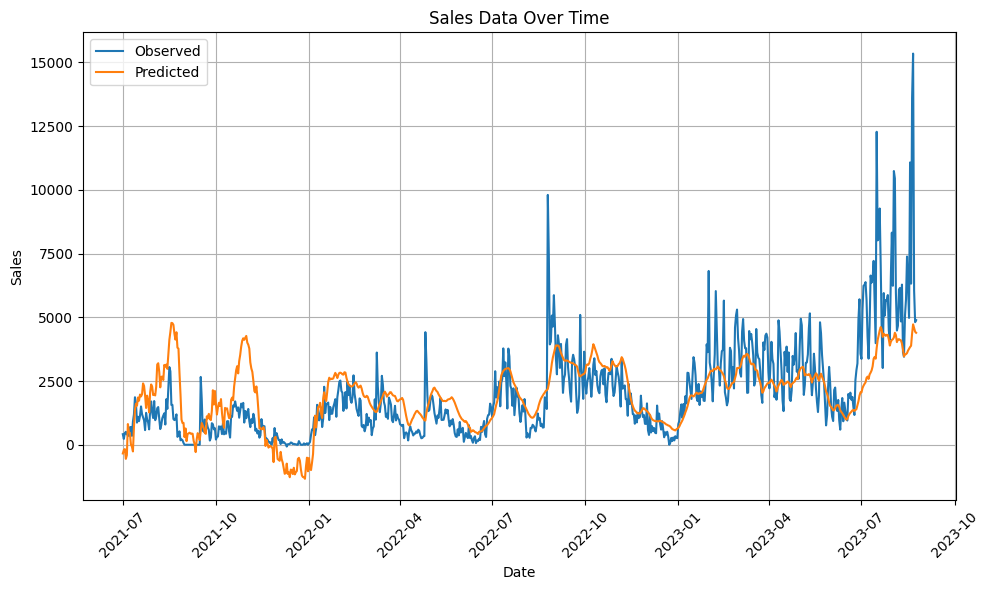

In [16]:
plt.figure(figsize=(10, 6))  # Adjust the figure size as needed

plt.plot(df.index, y_simple, linestyle='-', label = 'Observed')
plt.title('Sales Data Over Time')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.grid(True)
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability

# prediction graph
plt.plot(df.index, y_pred, linestyle='-', label = 'Predicted')
plt.title('Sales Data Over Time')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.grid(True)
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability

plt.legend()
plt.tight_layout()
plt.show()

In [17]:
from mamimo.time_utils import add_time_features, add_date_indicators

X_simple = (X_simple
     .pipe(add_time_features, month=True)
     .pipe(add_date_indicators, special_date=["2022-08-25"])
     .assign(trend=range(785))
)

In [18]:
from mamimo.time_utils import PowerTrend
from mamimo.carryover import ExponentialCarryover
from mamimo.saturation import ExponentialSaturation
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

cats =  [list(range(1, 13))] # different months, known beforehand

preprocess = ColumnTransformer(
    [
     ('facebook_pipe', Pipeline([
            ('carryover', ExponentialCarryover()),
            ('saturation', ExponentialSaturation())
     ]), ['facebook']),
     ('google_pipe', Pipeline([
            ('carryover', ExponentialCarryover()),
            ('saturation', ExponentialSaturation())
     ]), ['google']),
     ('tiktok_pipe', Pipeline([
            ('carryover', ExponentialCarryover()),
            ('saturation', ExponentialSaturation())
     ]), ['tiktok']),
    ('month', OneHotEncoder(sparse=False, categories=cats), ['month']),
    ('trend', PowerTrend(), ['trend']),
    ('special_date', ExponentialCarryover(), ['special_date'])
    ])

new_model = Pipeline([
    ('preprocess', preprocess),
    ('regression', LinearRegression(
        positive=True,
        fit_intercept=False) # no intercept because of the months
    )
])

In [19]:
new_model.fit(X_simple, y_simple)

/Users/valeriajimenez/.pyenv/versions/3.10.6/envs/MMM-project-lewagon/lib/python3.10/site-packages/sklearn/preprocessing/_encoders.py:972: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


Pipeline(steps=[('preprocess',
                 ColumnTransformer(transformers=[('facebook_pipe',
                                                  Pipeline(steps=[('carryover',
                                                                   ExponentialCarryover()),
                                                                  ('saturation',
                                                                   ExponentialSaturation())]),
                                                  ['facebook']),
                                                 ('google_pipe',
                                                  Pipeline(steps=[('carryover',
                                                                   ExponentialCarryover()),
                                                                  ('saturation',
                                                                   ExponentialSaturation())]),
                                                  ['google']),
                                                 ('tiktok_pipe',
                                                  Pipeline(steps=[('carryover',
                                                                   ExponentialCarryover()),
                                                                  ('saturation',
                                                                   ExponentialSaturation())]),
                                                  ['tiktok']),
                                                 ('month',
                                                  OneHotEncoder(categories=[[1,
                                                                             2,
                                                                             3,
                                                                             4,
                                                                             5,
                                                                             6,
                                                                             7,
                                                                             8,
                                                                             9,
                                                                             10,
                                                                             11,
                                                                             12]],
                                                                sparse=False),
                                                  ['month']),
                                                 ('trend', PowerTrend(),
                                                  ['trend']),
                                                 ('special_date',
                                                  ExponentialCarryover(),
                                                  ['special_date'])])),
                ('regression',
                 LinearRegression(fit_intercept=False, positive=True))])

In [20]:
new_model.fit(X_simple, y_simple).score(X_simple, y_simple)

/Users/valeriajimenez/.pyenv/versions/3.10.6/envs/MMM-project-lewagon/lib/python3.10/site-packages/sklearn/preprocessing/_encoders.py:972: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(


0.5256985493617197

In [21]:
y_pred = new_model.predict(X_simple)

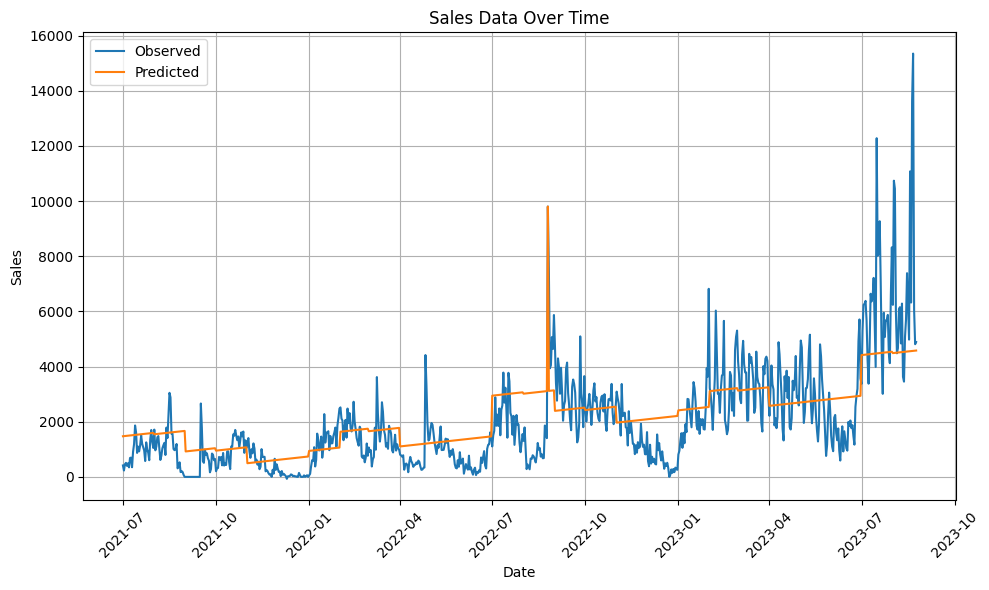

In [22]:
plt.figure(figsize=(10, 6))  # Adjust the figure size as needed

plt.plot(df.index, y_simple, linestyle='-', label = 'Observed')
plt.title('Sales Data Over Time')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.grid(True)
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability

# prediction graph
plt.plot(df.index, y_pred, linestyle='-', label = 'Predicted')
plt.title('Sales Data Over Time')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.grid(True)
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability

plt.legend()
plt.tight_layout()
plt.show()

In [23]:
import random

# Generate a list of random integers between 1 and 10
random_integers = [random.randint(1, 10) for _ in range(10)]
random_integers
random_uni = [random.uniform(0, 1) for _ in range(1)]
random_uni

[0.0001208830646299841]

In [ ]:
tuned_new_model = RandomizedSearchCV(
    new_model,
    param_distributions={
        'adstock__facebook_pipe__carryover__window': randint(1, 10),
        'adstock__facebook_pipe__carryover__strength': uniform(0, 1),
        'adstock__facebook_pipe__saturation__exponent': uniform(0, 1),
        'adstock__google_pipe__carryover__window': randint(1, 10),
        'adstock__google_pipe__carryover__strength': uniform(0, 1),
        'adstock__google_pipe__saturation__exponent': uniform(0, 1),
        'adstock__tiktok_pipe__carryover__window': randint(1, 10),
        'adstock__tiktok_pipe__carryover__strength': uniform(0, 1),
        'adstock__tiktok_pipe__saturation__exponent': uniform(0, 1),
        'preprocess__trend__power': uniform(0, 1),           # new
        'preprocess__special_date__window': randint(1, 10),  # new
        'preprocess__special_date__strength': uniform(0, 1), # new
    },
    cv=TimeSeriesSplit()
    n_iter=100
)

tuned_new_model.fit(X_simple, y_simple)

In [24]:
from scipy.stats import randint, uniform
from sklearn.model_selection import GridSearchCV, TimeSeriesSplit

tuned_new_model = GridSearchCV(
  new_model,
  param_grid={
    'preprocess__facebook_pipe__carryover__window': random_integers,
    'preprocess__facebook_pipe__carryover__strength': random_uni,
    'preprocess__facebook_pipe__saturation__exponent': random_uni,
    'preprocess__google_pipe__carryover__window': random_integers,
    'preprocess__google_pipe__carryover__strength': random_uni,
    'preprocess__google_pipe__saturation__exponent': random_uni,
    'preprocess__tiktok_pipe__carryover__window': random_integers,
    'preprocess__tiktok_pipe__carryover__strength': random_uni,
    'preprocess__tiktok_pipe__saturation__exponent': random_uni,
    'preprocess__trend__power': random_uni,           # new
    'preprocess__special_date__window': random_integers,  # new
    'preprocess__special_date__strength': random_uni, # new
  },
  cv=TimeSeriesSplit()
)


#tuned_new_model.fit(X_simple, y_simple)

/Users/valeriajimenez/.pyenv/versions/3.10.6/envs/MMM-project-lewagon/lib/python3.10/site-packages/sklearn/preprocessing/_encoders.py:972: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(
/Users/valeriajimenez/.pyenv/versions/3.10.6/envs/MMM-project-lewagon/lib/python3.10/site-packages/sklearn/preprocessing/_encoders.py:972: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(
/Users/valeriajimenez/.pyenv/versions/3.10.6/envs/MMM-project-lewagon/lib/python3.10/site-packages/sklearn/preprocessing/_encoders.py:972: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(
/Users/valeri

GridSearchCV(cv=TimeSeriesSplit(gap=0, max_train_size=None, n_splits=5, test_size=None),
             estimator=Pipeline(steps=[('preprocess',
                                        ColumnTransformer(transformers=[('facebook_pipe',
                                                                         Pipeline(steps=[('carryover',
                                                                                          ExponentialCarryover()),
                                                                                         ('saturation',
                                                                                          ExponentialSaturation())]),
                                                                         ['facebook']),
                                                                        ('google_pipe',
                                                                         Pipeline(steps=[('carryover',
                                                                                          ExponentialCarryover()),...
                         'preprocess__special_date__strength': [0.0001208830646299841],
                         'preprocess__special_date__window': [4, 4, 3, 9, 4, 1,
                                                              4, 9, 10, 2],
                         'preprocess__tiktok_pipe__carryover__strength': [0.0001208830646299841],
                         'preprocess__tiktok_pipe__carryover__window': [4, 4, 3,
                                                                        9, 4, 1,
                                                                        4, 9,
                                                                        10, 2],
                         'preprocess__tiktok_pipe__saturation__exponent': [0.0001208830646299841],
                         'preprocess__trend__power': [0.0001208830646299841]})

In [25]:
#tuned_new_model.fit(X_simple, y_simple).score(X_simple, y_simple) # score = 0.7337253942606274

/Users/valeriajimenez/.pyenv/versions/3.10.6/envs/MMM-project-lewagon/lib/python3.10/site-packages/sklearn/preprocessing/_encoders.py:972: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(
/Users/valeriajimenez/.pyenv/versions/3.10.6/envs/MMM-project-lewagon/lib/python3.10/site-packages/sklearn/preprocessing/_encoders.py:972: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(
/Users/valeriajimenez/.pyenv/versions/3.10.6/envs/MMM-project-lewagon/lib/python3.10/site-packages/sklearn/preprocessing/_encoders.py:972: FutureWarning: `sparse` was renamed to `sparse_output` in version 1.2 and will be removed in 1.4. `sparse_output` is ignored unless you leave `sparse` to its default value.
  warnings.warn(
/Users/valeri

0.7337253942606274

In [28]:
tuned_new_model.best_params_

params = {'preprocess__facebook_pipe__carryover__strength': 0.0001208830646299841,
 'preprocess__facebook_pipe__carryover__window': 1,
 'preprocess__facebook_pipe__saturation__exponent': 0.0001208830646299841,
 'preprocess__google_pipe__carryover__strength': 0.0001208830646299841,
 'preprocess__google_pipe__carryover__window': 4,
 'preprocess__google_pipe__saturation__exponent': 0.0001208830646299841,
 'preprocess__special_date__strength': 0.0001208830646299841,
 'preprocess__special_date__window': 9,
 'preprocess__tiktok_pipe__carryover__strength': 0.0001208830646299841,
 'preprocess__tiktok_pipe__carryover__window': 3,
 'preprocess__tiktok_pipe__saturation__exponent': 0.0001208830646299841,
 'preprocess__trend__power': 0.0001208830646299841}

In [30]:
y_pred = tuned_new_model.predict(X_simple)

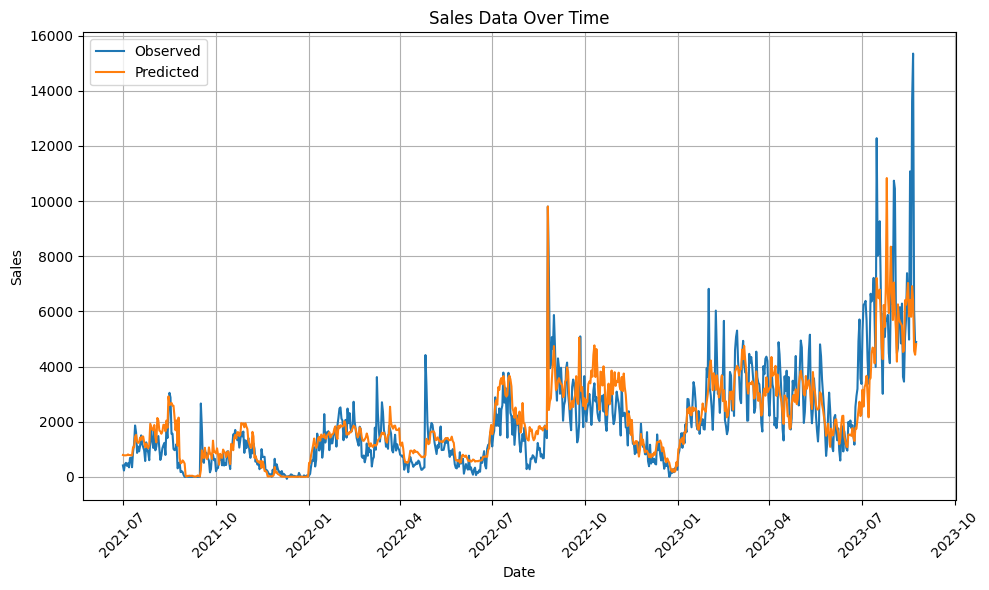

In [31]:
plt.figure(figsize=(10, 6))  # Adjust the figure size as needed

plt.plot(df.index, y_simple, linestyle='-', label = 'Observed')
plt.title('Sales Data Over Time')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.grid(True)
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability

# prediction graph
plt.plot(df.index, y_pred, linestyle='-', label = 'Predicted')
plt.title('Sales Data Over Time')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.grid(True)
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability

plt.legend()
plt.tight_layout()
plt.show()